# Retirement Planner

---

## Environment Setup

In [1]:
# Import libraries and dependencies
import numpy as np
import pandas as pd
import os
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import alpaca_trade_api as tradeapi
%matplotlib inline

In [2]:
# Set the random seed for resutls reproducibility (for testing purposes only)
np.random.seed(42)

---

## Portfolio Planner

In this activity, you will use the Alpaca API to grab historical data for a `60/40` portfolio using `SPY` to represent the stock portion and `AGG` to represent the bonds.

In [3]:
# Load .env enviroment variables
from dotenv import load_dotenv
load_dotenv()

# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

# Data Collection

In this step, you will need to use the Alpaca api to fetch closing prices for the `SPY` and `AGG` tickers. Save the results as a pandas DataFrame

In [4]:
# Subset your tickers, then pull returns data:
# Set the ticker
ticker = ["SPY", "AGG"]

# Set timeframe to '1D'
timeframe = "1D"

# Set start and end datetimes of 1 year, between now and 365 days ago.
start_date = pd.Timestamp('2019-01-01', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2019-12-31', tz='America/New_York').isoformat()

# Get 1 year's worth of historical data for SPY and AGG
df = api.get_barset(
    ticker,
    timeframe,
    limit=None,
    start=start_date,
    end=end_date,
    after=None,
    until=None,
).df

# Drop unnecessary columns
df = df.drop(
    columns=['open', 'high', 'low', 'volume'],
    level=1
)

In [5]:
# Display sample data
df.head()

,AGG,SPY
,close,close
2019-01-02 00:00:00-05:00,106.585,249.89
2019-01-03 00:00:00-05:00,107.020,244.46
2019-01-04 00:00:00-05:00,106.695,252.41
2019-01-07 00:00:00-05:00,106.470,254.40
2019-01-08 00:00:00-05:00,106.420,256.65


---

## Monte Carlo Simulation

In this step, you will run Monte Carlo Simulations for your portfolio to model portfolio performance at different retirement ages. 

Complete the following steps:

1. Calculate the daily returns for the SPY and AGG closing prices.

2. Calculate volatility for both the SPY and AGG closing prices.

3. Find the last day's closing price for both stocks and save those as variables

4. Run a Monte Carlo Simulation of at least `100` iterations and generate at least `30` years of closing prices

**Hint:** There are `252` trading days per year, so the number of records to generate for each Monte Carlo run will be `252 days * 30 years`.

In [5]:
# Since this is daily data, we can keep only the date (remove the time) component of the data
df.index = df.index.date

# Calculate the daily roi for the "SPY" and "AGG" stocks by using `pct_change` function
daily_returns = df.pct_change()
# Display sample data
daily_returns.head()

,AGG,SPY
,close,close
2019-01-02,NaN,NaN
2019-01-03,0.004081,-0.021730
2019-01-04,-0.003037,0.032521
2019-01-07,-0.002109,0.007884
2019-01-08,-0.000470,0.008844


In [6]:
# Use the `mean` function to calculate the mean of daily returns for "SPY", "AGG"
avg_daily_return_spy = daily_returns.mean()['SPY']['close']
avg_daily_return_agg = daily_returns.mean()['AGG']['close']
print(f"Average Daily Return of SPY stock is: {avg_daily_return_spy}")
print(f"Average Daily Return of AGG stock is: {avg_daily_return_agg}")

Average Daily Return of SPY stock is: 0.0010401250682146959
Average Daily Return of AGG stock is: 0.00021277231473764173


In [7]:
# Compute daily volatility
std_dev_daily_return_spy = daily_returns.std()['SPY']['close']
std_dev_daily_return_agg = daily_returns.std()['AGG']['close']
print(f"Daily Volatility of SPY stock is: {std_dev_daily_return_spy}")
print(f"Daily Volatility of AGG stock is: {std_dev_daily_return_agg}")

Daily Volatility of SPY stock is: 0.007820053413439366
Daily Volatility of AGG stock is: 0.002089826211646555


In [8]:
# Save the last day's closing price
spy_last_price = df['SPY']['close'][-1]
agg_last_price = df['AGG']['close'][-1]
print(f"Last Day's Closing Price of SPY stock is: {spy_last_price}")
print(f"Last Day's Closing Price of AGG stock is: {agg_last_price}")

Last Day's Closing Price of SPY stock is: 321.92
Last Day's Closing Price of AGG stock is: 112.37


In [16]:
# Setup the Monte Carlo Parameters
number_simulations = 500
number_records = 252 * 30
# Initialize empty DataFrame to hold simulated prices for each simulation
monte_carlo = pd.DataFrame()
portfolio_cumulative_returns = pd.DataFrame()

In [17]:
# Run the Monte Carlo Simulation

# Run the simulation of projecting stock prices for the next trading year, 600` times
for n in range(number_simulations):

    # Initialize the simulated prices list with the last closing price of `SPY` and `AGG`
    simulated_spy_prices = [spy_last_price]
    simulated_agg_prices = [agg_last_price]
    
    # Simulate the returns for 252 * 30 days
    for i in range(number_records):
        
        # Calculate the simulated price using the last price within the list
        simulated_spy_price = simulated_spy_prices[-1] * (1 + np.random.normal(avg_daily_return_spy, std_dev_daily_return_spy))
        simulated_agg_price = simulated_agg_prices[-1] * (1 + np.random.normal(avg_daily_return_agg, std_dev_daily_return_agg))
        
        # Append the simulated price to the list
        simulated_spy_prices.append(simulated_spy_price)
        simulated_agg_prices.append(simulated_agg_price)
    
    # Append the simulated prices of each simulation to DataFrame
    monte_carlo["SPY prices"] = pd.Series(simulated_spy_prices)
    monte_carlo["AGG prices"] = pd.Series(simulated_agg_prices)
    
    # Calculate the daily returns of simulated prices
    simulated_daily_returns = monte_carlo.pct_change()
    
    # Set the portfolio weights (60% SPY; 40% AGG)
    weights = [0.60, 0.40]

    # Use the `dot` function with the weights to multiply weights with each column's simulated daily returns
    portfolio_daily_returns = simulated_daily_returns.dot(weights)
    
    # Calculate the normalized, cumulative return series
    portfolio_cumulative_returns[n] = (1 + portfolio_daily_returns.fillna(0)).cumprod()

In [18]:
# Check that the simulation ran successfully
portfolio_cumulative_returns.tail()

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
7556,382.488672,103.059678,207.259283,321.454682,146.187199,99.347186,266.986549,88.328506,151.814237,181.156297,...,239.634542,149.915300,117.759915,588.439109,283.274540,87.915650,173.663872,90.570612,285.080588,189.931926
7557,380.249623,103.096939,205.991798,322.694043,145.743366,99.542167,267.812689,87.961459,152.429929,180.790894,...,237.313797,149.931447,117.060134,588.741218,282.854495,87.743848,172.935068,90.311831,284.545517,190.447884
7558,382.897543,103.404580,206.862275,322.428587,145.956597,99.770403,269.228208,87.712900,152.751050,180.666140,...,238.211185,150.345595,118.036522,593.328711,284.616333,86.714868,173.162587,89.829921,282.452005,191.538298
7559,381.938995,103.350221,206.646404,322.802659,146.027032,99.845074,271.801598,87.654205,153.417680,180.050571,...,236.788338,149.982847,117.903095,596.357089,282.747030,86.746697,173.079933,89.423813,282.572385,191.401436
7560,379.758363,102.661782,204.860757,321.584053,145.591492,100.506847,269.859490,87.626499,153.785918,181.577537,...,236.226442,150.639733,116.407575,593.098994,283.256291,87.059220,173.646987,89.299523,281.176339,191.523104


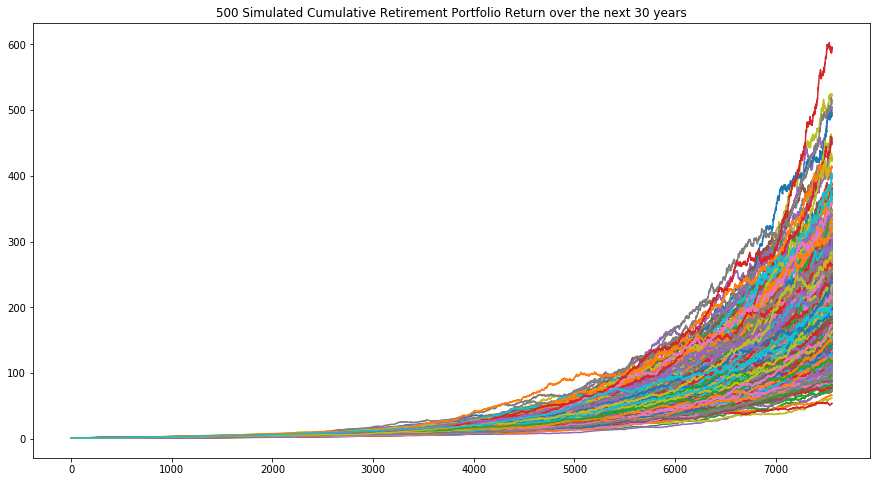

In [19]:
# Visualize the Simulation
plot_title = f"{n+1} Simulated Cumulative Retirement Portfolio Return over the next 30 years"
portfolio_cumulative_returns.plot(legend=None, title=plot_title, figsize=(15,8))

In [14]:
# Select the last row for the cumulative returns (cumulative returns at 20 years)
simulated_ending_prices_20 = portfolio_cumulative_returns.iloc[5039, :]
simulated_ending_prices_20.head()

0    29.848220
1    33.273443
2    25.674897
3    36.332989
4    40.466994
Name: 5039, dtype: float64

In [20]:
# Select the last row for the cumulative returns (cumulative returns at 30 years)
simulated_cum_ending_returns = portfolio_cumulative_returns.iloc[-1, :]
simulated_cum_ending_returns.head()

0    379.758363
1    102.661782
2    204.860757
3    321.584053
4    145.591492
Name: 7560, dtype: float64

In [27]:
#Range and Median of the cumulative returns
simulated_cum_ending_returns.min(), simulated_cum_ending_returns.max(), simulated_cum_ending_returns.median() 

(53.427559469254085, 593.0989937483133, 199.62794349330034)

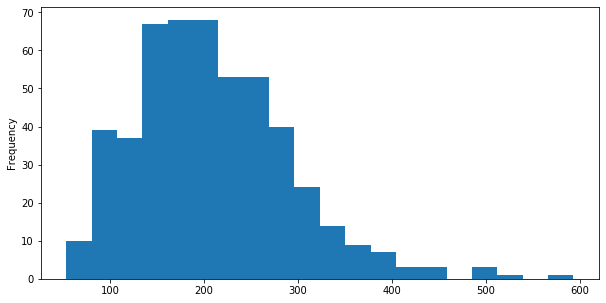

In [23]:
# Use the `quantile` function to calculate the 90% confidence interval for simulated ending prices
simulated_cum_ending_returns.plot(kind="hist", bins=20, figsize = (10,5))
simulated_cum_ending_returns.value_counts(bins=20) / len(simulated_cum_ending_returns)
confidence_interval = simulated_cum_ending_returns.quantile(q=[0.05, 0.95])

In [24]:
# Display the 90% confidence interval for the ending returns
confidence_interval

0.05     94.917270
0.95    359.924192
Name: 7560, dtype: float64

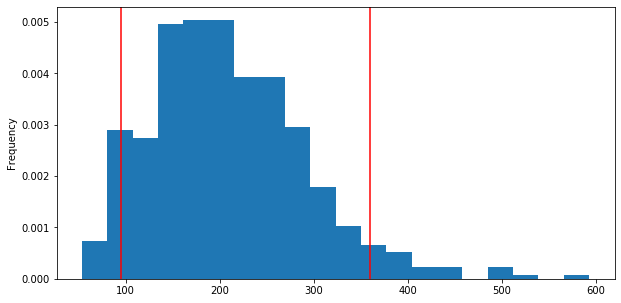

In [26]:
# Visualize the distribution of the ending returns
plt.figure();
simulated_cum_ending_returns.plot(kind='hist', density=True, bins=20, figsize = (10,5))
plt.axvline(confidence_interval.iloc[0], color='r')
plt.axvline(confidence_interval.iloc[1], color='r')

---

## Retirement Analysis

In this section, you will use the monte carlo model to answer the following retirement planning questions:

1. What are the expected cumulative returns at `30` years for the `10th`, `50th`, and `90th` percentiles?

2. Given an initial investment of `$20,000`, what is the expected return in dollars at the `10th`, `50th`, and `90th` percentiles?

3. Given the current projected annual income from the Plaid analysis, will a `4%` withdrawal rate meet or exceed that value at the `10th` percentile? Note: This is basically determining if retirement income is equivalent to current income.

4. How would a `50%` increase in the initial investment amount affect the `4%` retirement withdrawal? In other words, what happens if the initial investment had been bigger?

### What are the expected cumulative returns at 30 years for the 10th, 50th, and 90th percentiles?

In [28]:
# Compute cumulative returns
simulated_cum_ending_returns.quantile(q=[0.1, 0.5, 0.9])

0.1    108.819869
0.5    199.627943
0.9    309.710454
Name: 7560, dtype: float64

### Given an initial investment of `$20,000`, what is the expected portfolio return in dollars at the 10th, 50th, and 90th percentiles?

In [30]:
# Set initial investment
initial_investment = 20000
# Compute expected portfolio return
expected_portfolio_returns = round(initial_investment* simulated_cum_ending_returns.quantile(q=[0.1, 0.5, 0.9]))
# Print the results
print(f"Expected Cumulative Portfolio Returns at 30 years with an initial investment of $20,000, for the 10th, 50th and 90th percentiles are: \n{expected_portfolio_returns}")

Expected Cumulative Portfolio Returns at 30 years with an initial investment of $20,000, for the 10th, 50th and 90th percentiles are: 
0.1    2176397.0
0.5    3992559.0
0.9    6194209.0
Name: 7560, dtype: float64


### Given the current projected annual income from the Plaid analysis, will a 4% withdraw rate from the retirement portfolio meet or exceed that value at the 10th percentile?

Note: This is effectively saying that 90% of the expected returns will be greater than the return at the 10th percentile, so this can help measure the uncertainty about having enough funds at retirement

In [31]:
# Set Plaid's projected income
Projected_Plaid_Yearly_Income =  6085
# Calculate the 4% withdrawal for the ending return as retirement income
Retirement_Income = 0.04*(simulated_cum_ending_returns.quantile(.1)* initial_investment)
# Determine if the retirement income meets or exceeds the current projected income
if Retirement_Income > Projected_Plaid_Yearly_Income:
    print(f"Retirement_Income ${round(Retirement_Income)} exceeds Current Projected Income of {Projected_Plaid_Yearly_Income}")
elif Retirement_Income == Projected_Plaid_Yearly_Income:
    print(f"Retirement_Income ${round(Retirement_Income)} meets Current Projected Income of {Projected_Plaid_Yearly_Income}")
elif Retirement_Income < Projected_Plaid_Yearly_Income:
    print(f"Retirement_Income ${round(Retirement_Income)} is short of Current Projected Income of {Projected_Plaid_Yearly_Income}")

Retirement_Income $87056.0 exceeds Current Projected Income of 6085


### How would a 50% increase in the initial investment amount affect the 4% retirement withdrawal?

In [32]:
# Re-calculate the retirement income with a 50% increase in the initial investment amount
# Set initial investment
new_initial_investment = 20000*1.5
# Compute expected portfolio return
New_Retirement_Income = (0.04*new_initial_investment*simulated_cum_ending_returns.quantile(q=[0.1]))
# Print the results
print(f"Expected Cumulative Portfolio Returns at 30 years with an initial investment of ${new_initial_investment} at the 10th percentile exceeds Current projected Income of ${Projected_Plaid_Yearly_Income} ")

Expected Cumulative Portfolio Returns at 30 years with an initial investment of $30000.0 at the 10th percentile exceeds Current projected Income of $6085 


### Optional Challenge

Use the Monte Carlo data and calculate the cumulative returns at the `5%`, `50%`, and `95%` percentiles and plot this data as a line chart to see how the cumulative returns change over the life of the investment.

In this section, you need to calculate and plot the cumulative returns for the median and `90%` confidence intervals. This plot shows the expected cumulative returns for any given day between the first day and the last day of investment. 

In [33]:
# Compute projected returns
expected_portfolio_returns_5_per = []
expected_portfolio_returns_50_per = []
expected_portfolio_returns_95_per = []
new_returns_df = pd.DataFrame()
num_records = 252 * 5

for i in range(num_records):
    cum_returns_5 = portfolio_cumulative_returns.iloc[i].quantile(0.1)
    expected_portfolio_returns_5_per.append(cum_returns_5)
    
    cum_returns_50 = portfolio_cumulative_returns.iloc[i].quantile(0.5)
    expected_portfolio_returns_50_per.append(cum_returns_50)

    cum_returns_95 = portfolio_cumulative_returns.iloc[i].quantile(0.95)
    expected_portfolio_returns_95_per.append(cum_returns_95)

# Display sample data
new_returns_df["5% Quartile"] = pd.Series(expected_portfolio_returns_5_per)
new_returns_df["50% Quartile"] = pd.Series(expected_portfolio_returns_50_per)
new_returns_df["95% Quartile"] = pd.Series(expected_portfolio_returns_95_per)

# Print bottom records of cumulative returns data frame
new_returns_df.tail()

,5% Quartile,50% Quartile,95% Quartile
1255,1.942911,2.428088,3.254486
1256,1.947502,2.426119,3.252045
1257,1.945405,2.432962,3.238068
1258,1.945571,2.438385,3.266439
1259,1.943581,2.434926,3.258675


Text(0, 0.5, 'Expected Returns')

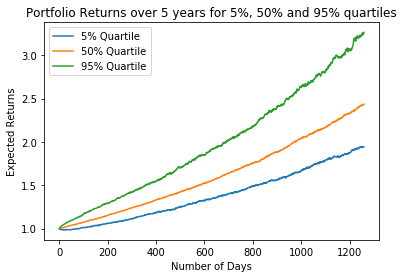

In [38]:
# Plot the cumulative returns over time
cumulative_returns = new_returns_df.plot(title="Portfolio Returns over 5 years for 5%, 50% and 95% quartiles")
cumulative_returns.set_xlabel("Number of Days")
cumulative_returns.set_ylabel("Expected Returns")

In [39]:
# Plot projected performance over time
cumulative_returns